<p style="align: center;"><img align=center src="https://s8.hostingkartinok.com/uploads/images/2018/08/308b49fcfbc619d629fe4604bceb67ac.jpg" width=500 height=450/></p>

<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Сегментация изображений</b></h3>


В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов. 

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import random

import numpy as np
import torch


SEED = 0

---


1.Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>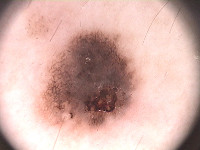</td><td>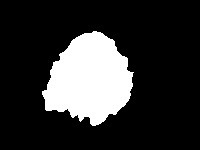</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем сегментировать их.

In [3]:
!wget https://www.dropbox.com/s/k88qukc20ljnbuo/PH2Dataset.rar

--2022-05-27 10:57:46--  https://www.dropbox.com/s/k88qukc20ljnbuo/PH2Dataset.rar
Resolving www.dropbox.com (www.dropbox.com)... 162.125.9.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.9.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/k88qukc20ljnbuo/PH2Dataset.rar [following]
--2022-05-27 10:57:47--  https://www.dropbox.com/s/raw/k88qukc20ljnbuo/PH2Dataset.rar
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucaa9efe897c214cd59a0ddd8d43.dl.dropboxusercontent.com/cd/0/inline/BmCYLvFPk_MG-GEQ8qqDPAXarf1yq16FoZKpBvOUi7i7FD7aFOJqsHbTOj4q5BjW3EiCNuKSrYfV_Kccr4Bl97URRhie-vy4Ds_PRkpcskShr2QR8p7thhPgmX9DdlGezwKfmPOY_GyMw3Zalc66L4VxoS5VZW6FMneXEpe1pMJxug/file# [following]
--2022-05-27 10:57:47--  https://ucaa9efe897c214cd59a0ddd8d43.dl.dropboxusercontent.com/cd/0/inline/BmCYLvFPk_MG-GEQ8qqDPAXarf1yq16FoZKpBvOUi7i7FD7aFOJqsHbTOj4q5B

In [4]:
get_ipython().system_raw("unrar x PH2Dataset.rar")

Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

Для загрузки датасета я предлагаю использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [5]:
import os

from skimage.io import imread



images = []
lesions = []
root = '/content/PH2Dataset'

for root, dirs, files in os.walk(os.path.join(root, 'PH2 Dataset images')):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize) можно использовать для изменения размера изображений. 
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [6]:
from skimage.transform import resize


IMG_SIZE = (256, 256)
X = [resize(x, IMG_SIZE, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, IMG_SIZE, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [7]:
import numpy as np


X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [8]:
len(lesions)

200

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

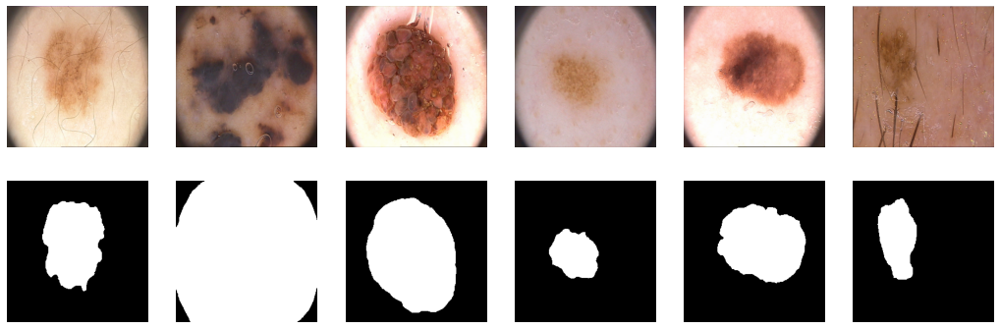

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output


plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i], cmap='gray')
plt.show();

Разделим наши 200 картинок на 100/50/50
 для валидации и теста

In [9]:
ix = np.random.choice(len(X), len(X), False)
tr, val, ts = np.split(ix, [100, 150])

In [10]:
print(len(tr), len(val), len(ts))

100 50 50


#### PyTorch DataLoader

In [11]:
from torch.utils.data import DataLoader


BATCH_SIZE = 7
data_tr = DataLoader(list(zip(np.moveaxis(X[tr], 3, 1), Y[tr, np.newaxis])), 
                     batch_size=BATCH_SIZE, shuffle=True)
data_val = DataLoader(list(zip(np.moveaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=BATCH_SIZE, shuffle=False)
data_ts = DataLoader(list(zip(np.moveaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=BATCH_SIZE, shuffle=False)

In [12]:
import torch


DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(DEVICE)

cuda


# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

# SegNet [2 балла]

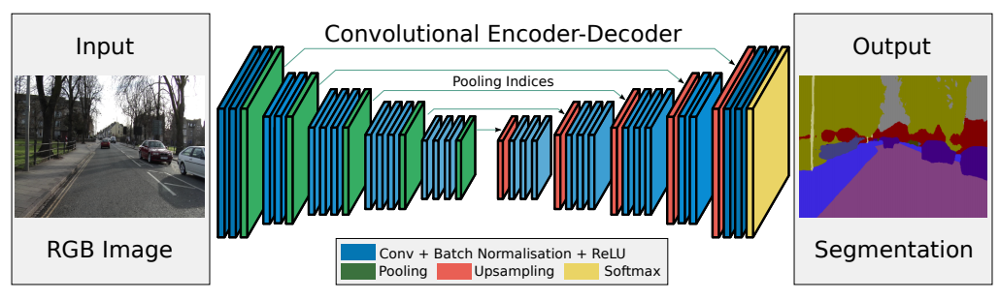

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

In [13]:
from time import time

from matplotlib import rcParams
import matplotlib.pyplot as plt
from IPython.display import clear_output

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torchvision import models

from torchsummary import summary

In [14]:
rcParams['figure.figsize'] = (15, 4)

In [ ]:
class SegNet(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 256 -> 128
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 128 -> 64
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 64 -> 32
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 32 -> 16
        self.enc_conv4 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
        )
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 16 -> 8
        
        # decoder (upsampling)
        self.upsample0 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 8 -> 16
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
        )
        self.upsample1 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 16 -> 32
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),
        )
        self.upsample2 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 32 -> 64
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),
        )
        self.upsample3 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 64 -> 128
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),
        )
        self.upsample4 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 128 -> 256
        self.dec_conv4 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=3, padding=1),
        )

    def forward(self, x):
        
        # encoder
        x = self.enc_conv0(x)
        x, inds0 = self.pool0(x)
        x = self.enc_conv1(x)
        x, inds1 = self.pool1(x)
        x = self.enc_conv2(x)
        x, inds2 = self.pool2(x)
        x = self.enc_conv3(x)
        x, inds3 = self.pool3(x)
        x = self.enc_conv4(x)
        x, inds4 = self.pool4(x)
        
        # decoder
        x = self.upsample0(x, inds4)
        x = self.dec_conv0(x)
        x = self.upsample1(x, inds3)
        x = self.dec_conv1(x)
        x = self.upsample2(x, inds2)
        x = self.dec_conv2(x)
        x = self.upsample3(x, inds1)
        x = self.dec_conv3(x)
        x = self.upsample4(x, inds0)
        x = self.dec_conv4(x)
        return x

In [ ]:
model = SegNet().to(DEVICE)
summary(model, (3, *IMG_SIZE));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
         MaxPool2d-7  [[-1, 64, 128, 128], [-1, 64, 128, 128]]               0
            Conv2d-8        [-1, 128, 128, 128]          73,856
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,584
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
        MaxPool2d-14  [[

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


To clarify this we can see on the segmentation:
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


And the intersection will be the following:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [15]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # print(f"{outputs.shape = }")
    # print(f"{labels.shape = }")
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    # print(f"{outputs = }")
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    # print(f"{labels = }")
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    # print(f"{thresholded.shape = }")
    return thresholded.mean().item()  # 

## Функция потерь [1 балл]

Теперь не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации. 

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits) в Тарая функция эквивалентна и не так подвержена численной неустойчивости.

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [16]:
def bce_loss(y_pred, y_real):
    # please don't use nn.BCELoss. write it from scratch
    return (y_pred - y_real * y_pred + torch.log(1 + torch.exp(-y_pred))).mean()

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [17]:
batch_val = next(iter(data_val))

def show_some_samples(
        model, batch_val=batch_val, leave_only_last=True,
        title=f"Samples from given batch_val (current epoch)"):

    X_val, Y_val = batch_val
    was_training = model.training
    model.eval()
    with torch.no_grad():
        Y_hat = torch.sigmoid(model(X_val.to(DEVICE))).cpu()
        Y_pred_labels = Y_hat >= 0.5

    if leave_only_last:
        clear_output(wait=True)
    vert, horiz = 3, 6
    plt.figure(figsize=(15, 6))
    for k in range(1, horiz + 1):
        plt.subplot(vert, horiz, k)
        plt.imshow(np.moveaxis(X_val[k].numpy(), 0, 2), cmap='gray')
        plt.title('Real')
        plt.axis('off')
        
        plt.subplot(vert, horiz, k + 1 * horiz)
        plt.imshow(np.moveaxis(Y_val[k].numpy(), 0, 2).squeeze(-1), cmap='gray')
        plt.title('Ground truth')
        plt.axis('off')
        
        plt.subplot(vert, horiz, k + 2 * horiz)
        plt.imshow(Y_pred_labels[k, 0].numpy(), cmap='gray')
        plt.title('Predicted labels')
        plt.axis('off')
    plt.suptitle(title)
    plt.show()
    model.train(was_training)

In [18]:
from enum import Enum
from typing import Optional
from typing_extensions import Literal


from matplotlib import pyplot as plt
from torch import nn
from tqdm.notebook import tqdm, trange

class TrainType(Enum):
    TRAIN = "train"
    FULL = "full"

    def __str__(self):
        return self.value.lower()


MODEL_FILENAME_FMT = "{model_name}.{train_type}.{device_type}.tar"
MODEL_STORAGE_DIR = "./trained_models"

def save_model(model, optimizer, epoch, loss, model_name, path, lr_scheduler=None, metrics=None):
    state = {
        'model_name': model_name,
        'model_state': model.state_dict(),
        'optimizer_state': optimizer.state_dict(),
        'lr_scheduler_state': None if lr_scheduler is None else lr_scheduler.state_dict(),
        'epoch': epoch,
        'loss': loss,
        'metrics': metrics
    }
    directory = os.path.dirname(os.path.abspath(path))
    os.makedirs(directory, exist_ok=True)
    torch.save(state, path)

def load_model_state_and_info(model_name, train_type, device_type):
    path = os.path.join(
        MODEL_STORAGE_DIR,
        MODEL_FILENAME_FMT.format(
            model_name=model_name,
            train_type=train_type,
            device_type=device_type
        )
    )
    return torch.load(path)

def show_plots(train_loss, train_metrics, val_loss, val_metrics, model_name=""):
    plt.figure(figsize=(15, 9))
    plt.plot(np.arange(1, len(train_loss) + 1), train_loss, label="train_loss")
    plt.plot(np.arange(1, len(val_loss) + 1), val_loss, label="val_loss")
    best_epoch = np.argmin(val_loss) + 1
    plt.axvline(best_epoch, color='r', label="best epoch by loss")
    plt.legend(loc='best')
    plt.title(model_name)
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.show()
    
    plt.figure(figsize=(15, 9))
    for name, values in train_metrics.items():
        plt.plot(np.arange(1, len(values) + 1), values, label="train_{}".format(name))
    for name, values in val_metrics.items():
        plt.plot(np.arange(1, len(values) + 1), values, label="val_{}".format(name))
        best_epoch = np.argmax(values) + 1
        plt.axvline(best_epoch, color='r', label="best epoch by {}".format(name))
    plt.legend(loc='best')
    plt.title(model_name)
    plt.xlabel("epoch")
    plt.ylabel("metric")
    plt.show()

def print_best_epoch(metric_values, metric_name='metric', type: Optional[Literal['max', 'min']]='max', model_name='model'):
    if type == 'max':
        func = np.argmax
    elif type == 'min':
        func == np.argmin
    else:
        raise ValueError("`type` must be 'min' or 'max'")
    epoch = func(metric_values)
    best_metric_value = metric_values[epoch]
    epoch += 1
    print("{}: best {} value {} on {} epoch.".format(model_name, metric_name, best_metric_value, epoch))

def multiclass_get_labels(output):
    return output.argmax(-1)

def one_class_get_labels(output):
    return torch.sigmoid(output) >= 0.5

def epoch_train_stage(model, data_loader, criterion, optimizer, device, model_output_to_predict):
    loss_sum = 0
    y_true = []
    y_pred = []
    was_training = model.training
    model.train()
    for data, labels in tqdm(data_loader, desc="train batches", leave=False):
        data, labels = data.to(device), labels.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, labels)
        loss.backward()
        optimizer.step()

        loss_sum += loss.item()
        pred = model_output_to_predict(output)
        y_true.append(labels)
        y_pred.append(pred)
    with torch.no_grad():
        y_true = torch.cat(y_true)
        y_pred = torch.cat(y_pred)
    model.train(was_training)
    return loss_sum / len(data_loader), y_pred, y_true


def epoch_val_stage(model, data_loader, criterion, device, model_output_to_predict):
    loss_sum = 0
    y_true = []
    y_pred = []
    was_training = model.training
    model.eval()
    with torch.no_grad():
        for data, labels in tqdm(data_loader, desc="val batches", leave=False):
            data, labels = data.to(device), labels.to(device)
            output = model(data)
            loss = criterion(output, labels)

            loss_sum += loss.item()
            pred = model_output_to_predict(output)
            y_true.append(labels)
            y_pred.append(pred)

        y_true = torch.cat(y_true)
        y_pred = torch.cat(y_pred)

    model.train(was_training)
    return loss_sum / len(data_loader), y_pred, y_true


def train_model(
        model, train_loader, val_loader, criterion, optimizer, epochs, device, model_output_to_predict,
        metrics, main_metric_name=None, save_best=False, model_name=None, logs_dir=MODEL_STORAGE_DIR,
        lr_scheduler=None, print_samples_callback=None):
    if model_name is None:
        model_name = model.__class__.__name__
    if not isinstance(metrics, dict):
        metrics = {metric.__name__: metric for metric in metrics}
    if save_best and main_metric_name is None:
        raise ValueError("You should set `main_metric_name` when `save_best` is True")
    if main_metric_name not in metrics:
        raise ValueError("`main_metric_name` \"{}\" not found in `metrics`".format(main_metric_name))

    train_losses = []
    train_metrics = {name: [] for name in metrics}
    val_losses = []
    val_metrics = {name: [] for name in metrics}
    best_epoch = -1
    history = [
        train_losses,
        train_metrics,
        val_losses,
        val_metrics,
    ]
    model = model.to(device)
    best_metric_value = None
    with trange(1, epochs + 1, desc="epochs") as pbar:
        for i in pbar:
            train_loss, *train_ypt = epoch_train_stage(model, train_loader, criterion, optimizer, device, model_output_to_predict)
            train_losses.append(train_loss)
            for name, metric in metrics.items():
                train_metrics[name].append(metric(*train_ypt))
            val_loss, *val_ypt = epoch_val_stage(model, val_loader, criterion, device, model_output_to_predict)
            if lr_scheduler is not None:
                lr_scheduler.step()
            val_losses.append(val_loss)
            for name, metric in metrics.items():
                val_metrics[name].append(metric(*val_ypt))
            if save_best and (best_metric_value is None or best_metric_value < val_metrics[main_metric_name][-1]):
                best_metric_value = val_metrics[main_metric_name][-1]
                model_filename = MODEL_FILENAME_FMT.format(
                    model_name=model_name, train_type=TrainType.TRAIN, device_type=device.type)
                save_model(
                    model, optimizer, i, val_loss,
                    model_name=model_name,
                    path=os.path.join(logs_dir, model_filename),
                    lr_scheduler=lr_scheduler, metrics={name: value_list[-1] for name, value_list in val_metrics.items()})
            pbar.set_postfix(
                t_loss=train_loss, v_loss=val_loss,
                **{"t_" + name: value_list[-1] for name, value_list in train_metrics.items()},
                **{"v_" + name: value_list[-1] for name, value_list in val_metrics.items()})
            if print_samples_callback is not None:
                print_samples_callback(model)
    return history

def refit(
        model, data_loader, criterion, optimizer, epochs, device,
        metrics, main_metric_name=None, save_best=False, model_name=None, logs_dir=MODEL_STORAGE_DIR, lr_scheduler=None):
    if model_name is None:
        model_name = model.__class__.__name__
    if not isinstance(metrics, dict):
        metrics = {metric.__name__: metric for metric in metrics}
    if save_best and main_metric_name is None:
        raise ValueError("You should set `main_metric_name` when `save_best` is True")
    if main_metric_name not in metrics:
        raise ValueError("`main_metric_name` \"{}\" not found in `metrics`".format(main_metric_name))

    train_losses = []
    train_metrics = {name: [] for name in metrics}
    best_epoch = -1
    history = [
        train_losses,
        train_metrics
    ]
    model = model.to(device)
    best_metric_value = None
    with trange(1, epochs + 1, desc="epochs") as pbar:
        for i in pbar:
            train_loss, *train_ypt = epoch_train_stage(model, data_loader, criterion, optimizer, device)
            train_losses.append(train_loss)
            for name, metric in metrics.items():
                train_metrics[name].append(metric(*train_ypt))
            if lr_scheduler is not None:
                lr_scheduler.step()
            if save_best and (best_metric_value is None or best_metric_value < train_metrics[main_metric_name][-1]):
                best_metric_value = train_metrics[main_metric_name][-1]
                model_filename = MODEL_FILENAME_FMT.format(
                    model_name=model_name, train_type=TrainType.FULL, device_type=device.type)
                save_model(
                    model, optimizer, i, train_loss,
                    model_name=model_name,
                    path=os.path.join(logs_dir, model_filename),
                    lr_scheduler=lr_scheduler, metrics={name: value_list[-1] for name, value_list in train_metrics.items()})
            pbar.set_postfix(
                t_loss=train_loss,
                **{"t_" + name: value_list[-1] for name, value_list in train_metrics.items()})
    return history

## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [19]:
def predict(model, data):
    model.eval()  # testing mode
    Y_pred = []
    with torch.no_grad():
        Y_pred.extend([(torch.sigmoid(model(X_batch)) >= 0.5) for X_batch, _ in data])
    return torch.cat(Y_pred)

In [20]:
def score_model(model, metric, data):
    model.eval()  # testing mode
    y_pred = []
    y_label = []
    with torch.no_grad():
        for X_batch, Y_label in data:
            y_label.append(Y_label.to(DEVICE))
            y_pred.append(torch.sigmoid(model(X_batch.to(DEVICE))) >= 0.5)
    y_pred = torch.cat(y_pred)
    y_label = torch.cat(y_label)
    return metric(y_pred, y_label)

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


In [21]:
models_data = {
    "model & loss": [],
    "best epoch": [],
    "train loss": [],
    "val IoU": [],
    "test IoU": [],
}

def update_models_data(model_name, best_epoch, train_loss, val_metric, test_metric):
    models_data["model & loss"].append(model_name)
    models_data["best epoch"].append(best_epoch)
    models_data["train loss"].append(train_loss)
    models_data["val IoU"].append(val_metric)
    models_data["test IoU"].append(test_metric)

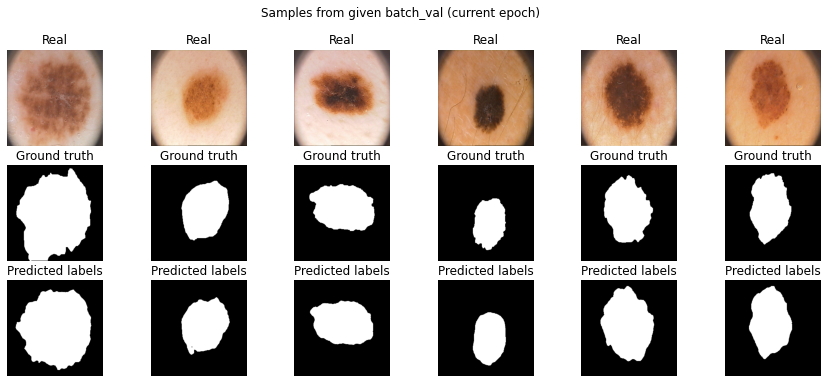

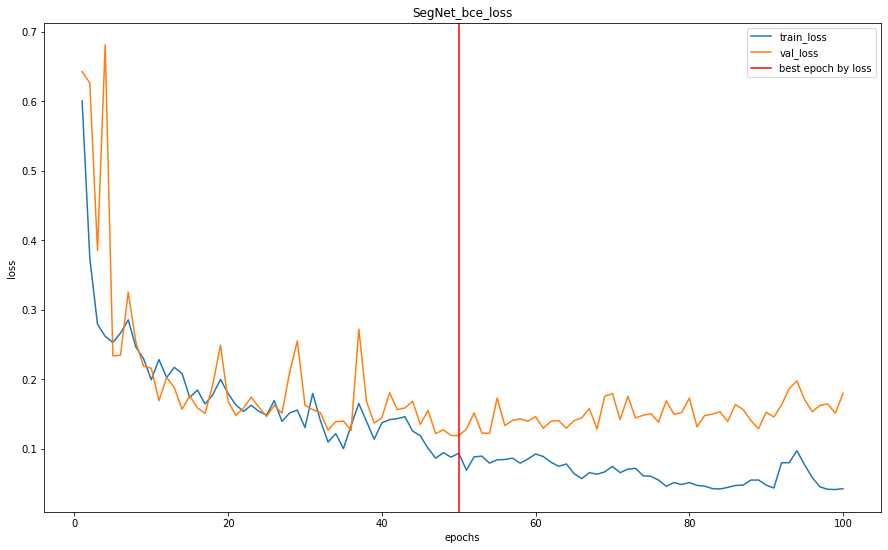

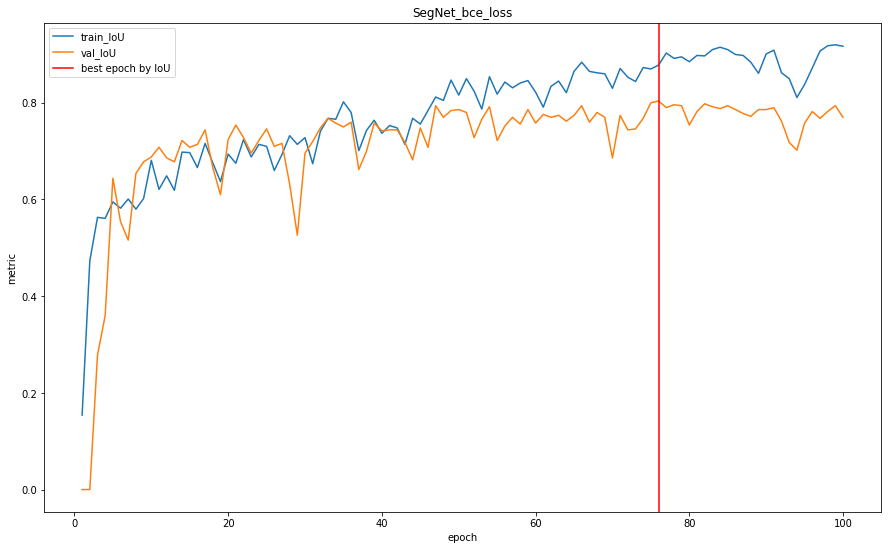

SegNet_bce_loss: best IoU value 0.8040000200271606 on 76 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = SegNet().to(DEVICE)
model_name = "SegNet_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4)


train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

Лучшая модель:

In [ ]:
model_name = "SegNet_bce_loss"
net = SegNet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])

best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("SegNet & bce loss", best_epoch, train_loss, val_score, test_score)
val_score

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


0.8040000200271606

Пример результатов сегментации:

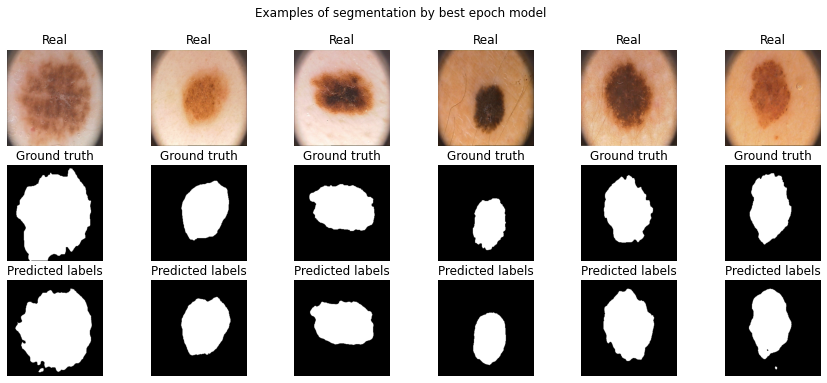

In [ ]:
show_some_samples(net, title="Examples of segmentation by best epoch model")

Ответьте себе на вопрос: не переобучается ли моя модель?

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла] 

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss. 
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало, прежде чем бить тревогу попробуйте поперебирать различные варианты, убедитесь, что во всех других сетапах сетть достигает желанного результата. СПОЙЛЕР: учиться она будеет при всех лоссах предложенных в этом задании.


**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \sum_i\frac{2X_iY_i}{X_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникаемой в математической формуле.


In [22]:
def dice_loss(logits, y_real, eps=1e-8):
    y_pred = torch.sigmoid(logits)
    num = (2 * y_pred * y_real).sum((-2, -1))
    den =  (y_pred + y_real).sum((-2, -1))
    res = 1 - ((num + eps) / (den + eps)).mean()
    return res

Проводим тестирование:

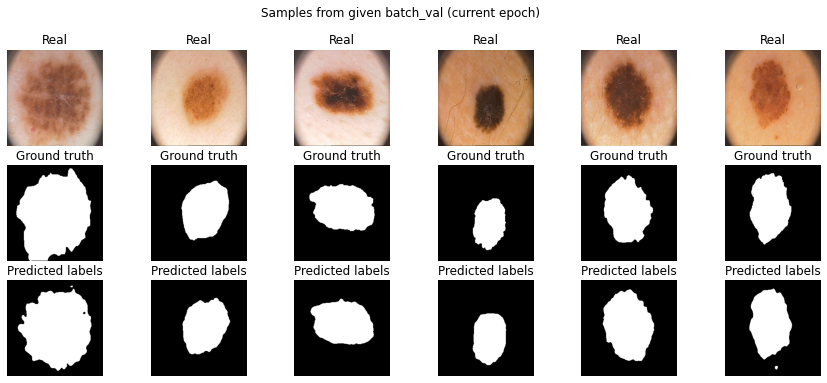

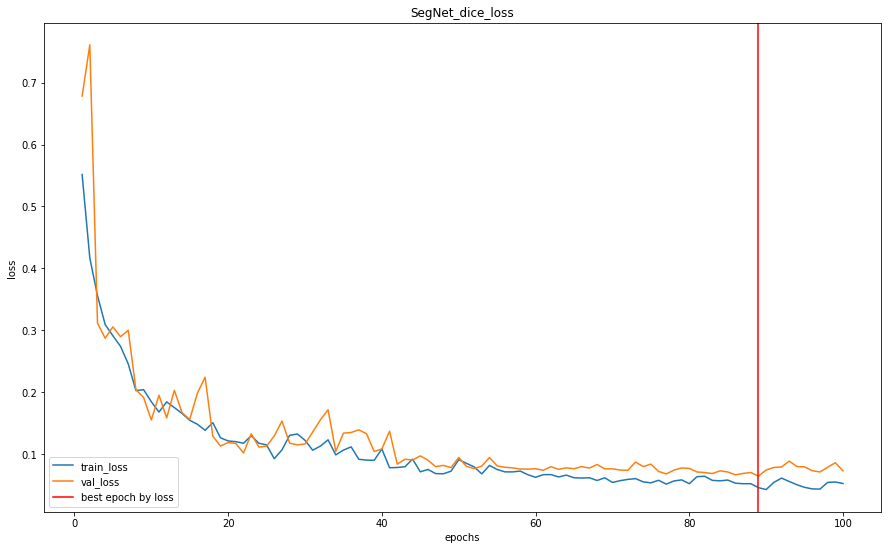

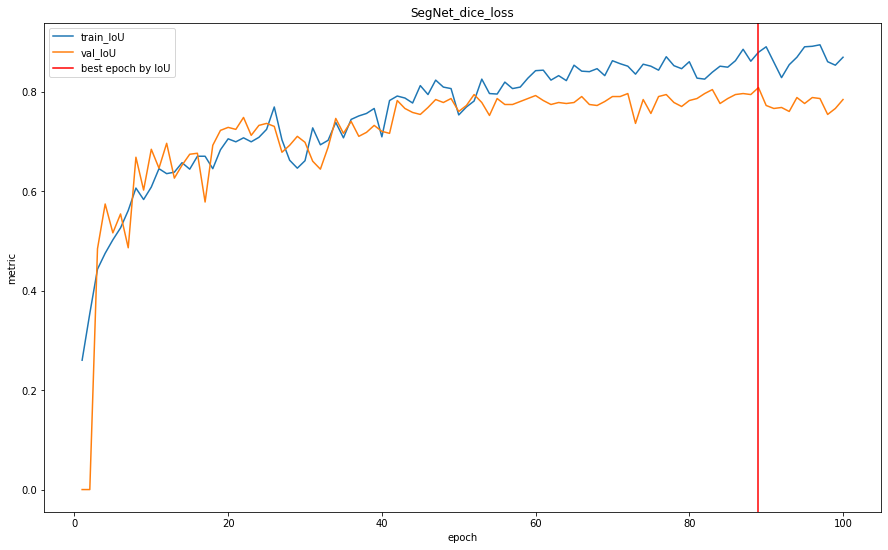

SegNet_dice_loss: best IoU value 0.8080000281333923 on 89 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = SegNet().to(DEVICE)
model_name = "SegNet_dice_loss"
criterion = dice_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4)


train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

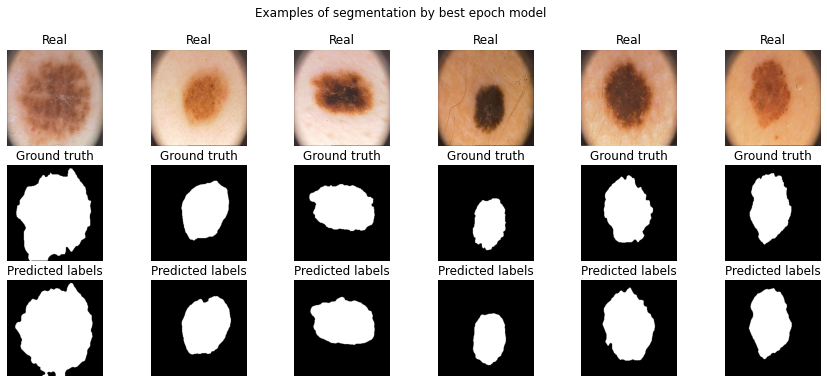

0.8080000281333923

In [ ]:
model_name = "SegNet_dice_loss"
net = SegNet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("SegNet & dice loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf) 

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [23]:
def focal_loss(y_pred, y_real, eps=1e-8, gamma=2):
    # y_pred =  # hint: torch.clamp
    pos_cls_freq = y_real.sum() / y_real.numel()
    alpha = y_real * (1 - pos_cls_freq) + (1 - y_real) * pos_cls_freq
    probs = torch.sigmoid(y_pred)
    pt = y_real * probs + (1 - y_real) * (1 - probs)
    weight = torch.pow(1 - pt, gamma)
    bce = y_real * y_pred - y_pred - torch.log(1 + torch.exp(-y_pred))
    your_loss = -(alpha * weight * bce).mean()
    return your_loss


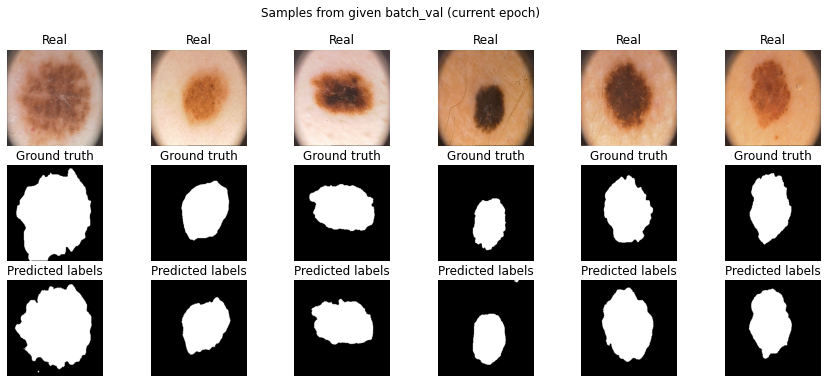

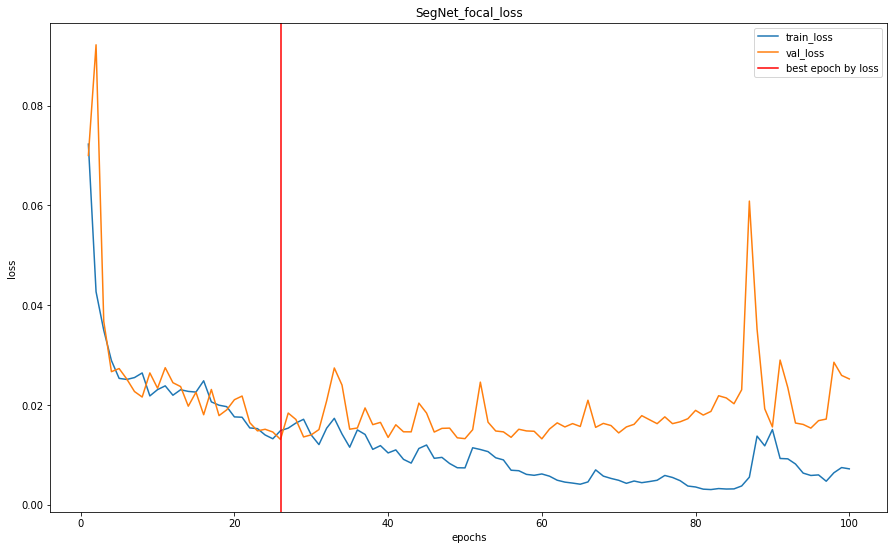

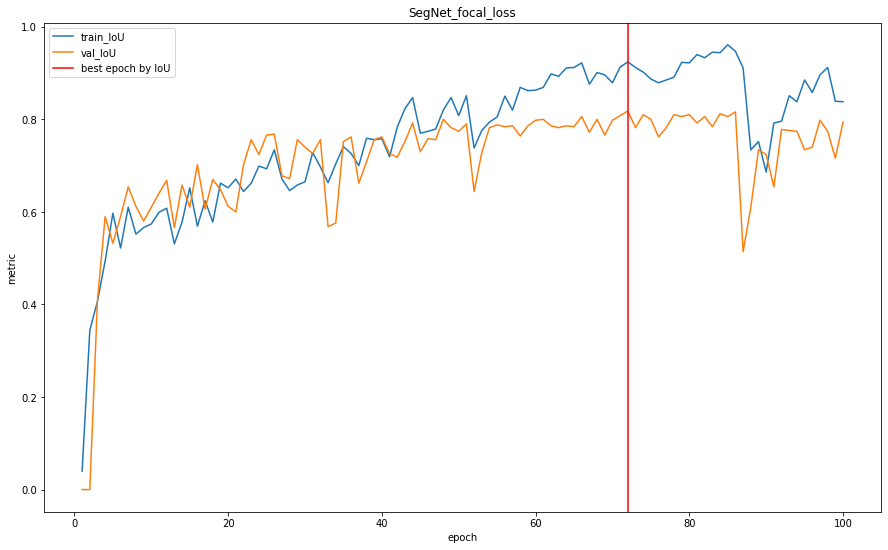

SegNet_focal_loss: best IoU value 0.8180000185966492 on 72 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = SegNet().to(DEVICE)
model_name = "SegNet_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'

optimizer = torch.optim.Adam(net.parameters(), lr=1e-4)

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

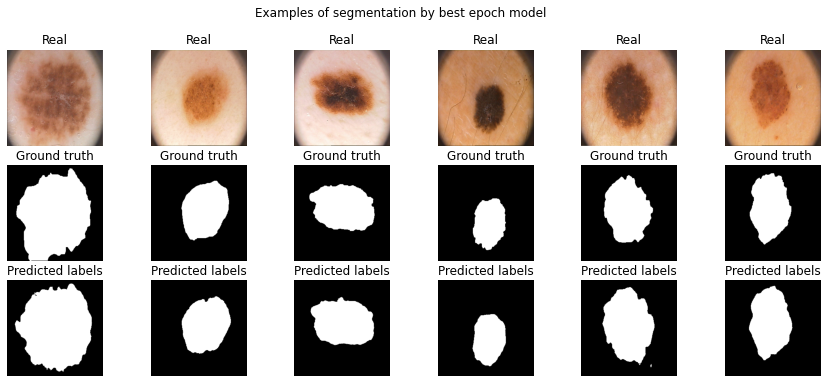

0.8180000185966492

In [ ]:
model_name = "SegNet_focal_loss"
net = SegNet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("SegNet & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

----------------------------------------------------------------------------------------------

## [BONUS] Мир сегментационных лоссов [5 баллов]

В данном блоке предлагаем вам написать одну функцию потерь самостоятельно. Для этого необходимо прочитать статью и имплементировать ее. Кроме тако провести численное сравнение с предыдущими функциями.
Какие варианты? 

1) Можно учесть Total Variation
2) Lova
3) BCE но с Soft Targets (что-то типа label-smoothing для многослассовой классификации)
4) Любой другой 

* [Physiological Inspired Deep Neural Networks for Emotion Recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=8472816&tag=1)". IEEE Access, 6, 53930-53943.

* [Boundary loss for highly unbalanced segmentation](https://arxiv.org/abs/1812.07032)

* [Tversky loss function for image segmentation using 3D fully convolutional deep networks](https://arxiv.org/abs/1706.05721)

* [Correlation Maximized Structural Similarity Loss for Semantic Segmentation](https://arxiv.org/abs/1910.08711)

* [Topology-Preserving Deep Image Segmentation](https://papers.nips.cc/paper/8803-topology-preserving-deep-image-segmentation)

Так как Тверский лосс очень похож на данные выше, то за него будет проставлено только 3 балла (при условии, если в модели нет ошибок при обучении). Постарайтесь сделать что-то интереснее.

### Correlation Maximized Structural Similarity Loss for Semantic Segmentation


Гауссово сглаживание

In [24]:
import math
import numbers

import torch
from torch import nn
from torch.nn import functional as F


class GaussianSmoothing(nn.Module):
    """
    Apply gaussian smoothing on a
    1d, 2d or 3d tensor. Filtering is performed seperately for each channel
    in the input using a depthwise convolution.
    Arguments:
        channels (int, sequence): Number of channels of the input tensors. Output will
            have this number of channels as well.
        kernel_size (int, sequence): Size of the gaussian kernel.
        sigma (float, sequence): Standard deviation of the gaussian kernel.
        dim (int, optional): The number of dimensions of the data.
            Default value is 2 (spatial).
    """

    def __init__(self, channels, kernel_size, sigma, dim=2):
        super(GaussianSmoothing, self).__init__()
        if isinstance(kernel_size, numbers.Number):
            kernel_size = [kernel_size] * dim
        if isinstance(sigma, numbers.Number):
            sigma = [sigma] * dim

        # The gaussian kernel is the product of the
        # gaussian function of each dimension.
        kernel = 1
        meshgrids = torch.meshgrid(
            [
                torch.arange(size, dtype=torch.float32)
                for size in kernel_size
            ]
        )
        for size, std, mgrid in zip(kernel_size, sigma, meshgrids):
            mean = (size - 1) / 2
            kernel *= 1 / (std * math.sqrt(2 * math.pi)) * \
                torch.exp(-((mgrid - mean) / std) ** 2 / 2)

        # Make sure sum of values in gaussian kernel equals 1.
        kernel = kernel / torch.sum(kernel)

        # Reshape to depthwise convolutional weight
        kernel = kernel.view(1, 1, *kernel.size())
        kernel = kernel.repeat(channels, *[1] * (kernel.dim() - 1))

        self.register_buffer('weight', kernel)
        self.groups = channels

        if dim == 1:
            self.conv = F.conv1d
        elif dim == 2:
            self.conv = F.conv2d
        elif dim == 3:
            self.conv = F.conv3d
        else:
            raise RuntimeError(
                'Only 1, 2 and 3 dimensions are supported. Received {}.'.format(
                    dim)
            )

    def forward(self, input):
        """
        Apply gaussian filter to input.
        Arguments:
            input (torch.Tensor): Input to apply gaussian filter on.
        Returns:
            filtered (torch.Tensor): Filtered output.
        """
        return self.conv(input, weight=self.weight, groups=self.groups)

Оценка статистики

In [ ]:
class LocalStatisticEstimation(nn.Module):
    def __init__(self, channels, kernel_size, sigma, eps=1e-8):
        super().__init__()
        self.gaussian_filter = GaussianSmoothing(
            channels, kernel_size, sigma, dim=2)
        padding = (kernel_size - 1) // 2
        self.pad = nn.ZeroPad2d(padding)
        self.eps = eps

    def forward(self, input):
        padded = self.pad(input)
        mean = self.gaussian_filter(padded)
        mean_subtracted_then_padded = self.pad(input - mean)
        filtered = self.gaussian_filter(mean_subtracted_then_padded ** 2)
        std = torch.sqrt(filtered + self.eps)
        return mean, std

### Функция потерь

Функция потерь *Структурного сходства (SSL)*

In [ ]:
class CorrelationMaximizedStructuralSimilarityLoss(nn.modules.loss._Loss):
    def __init__(self, channels, kernel_size=3, sigma=1.5, beta=0.1, lambda_=0.5, stability_factor=0.01, eps=1e-8):
        super().__init__()
        self.local_statistic = LocalStatisticEstimation(
            channels, kernel_size, sigma)
        self.beta = beta
        self.lambda_ = lambda_
        self.stability_factor = stability_factor
        self.eps = eps

    def forward(self, input, target):
        probs = torch.sigmoid(input)
        probs_mean, probs_std = self.local_statistic(probs)
        target_mean, target_std = self.local_statistic(target)
        probs_normalized = (
            probs - probs_mean + self.stability_factor) / (probs_std + self.stability_factor)
        target_normalized = (
            target - target_mean + self.stability_factor) / (target_std + self.stability_factor)
        error_max = target_normalized.max() - target_normalized.min()
        error = torch.abs(target_normalized - probs_normalized)
        fnc = error > self.beta * error_max
        loss_bce = input - target * input  + torch.log(1 + torch.exp(-input))
        loss_lss = error * fnc * loss_bce
        M = fnc.sum((-2, -1))
        loss_lss_image = (loss_lss.sum((-2, -1)) + self.eps) / (M + self.eps)
        loss_bce_image = loss_bce.mean((-2, -1))
        return torch.mean(self.lambda_ * loss_bce_image + (1 - self.lambda_) * loss_lss_image)

Тренировка модели

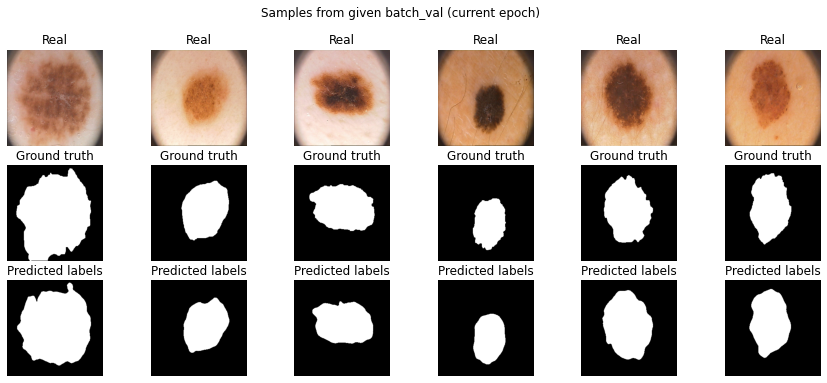

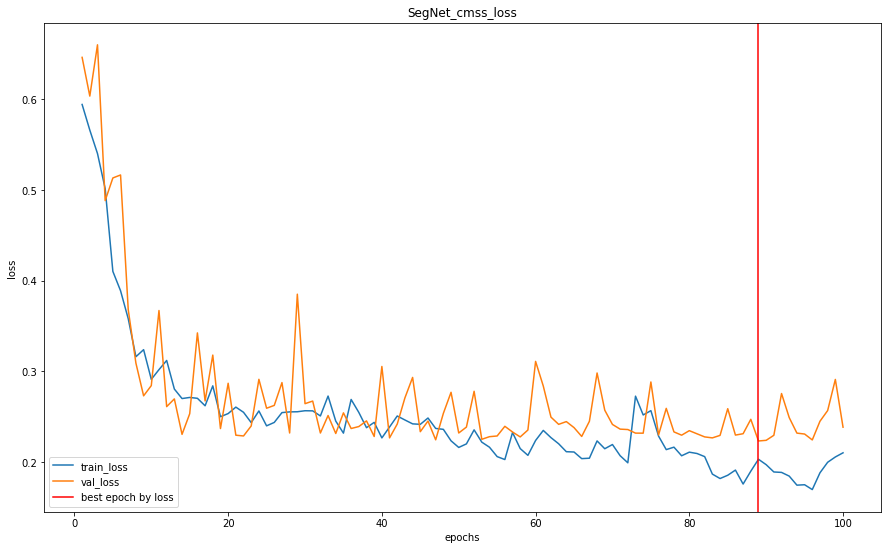

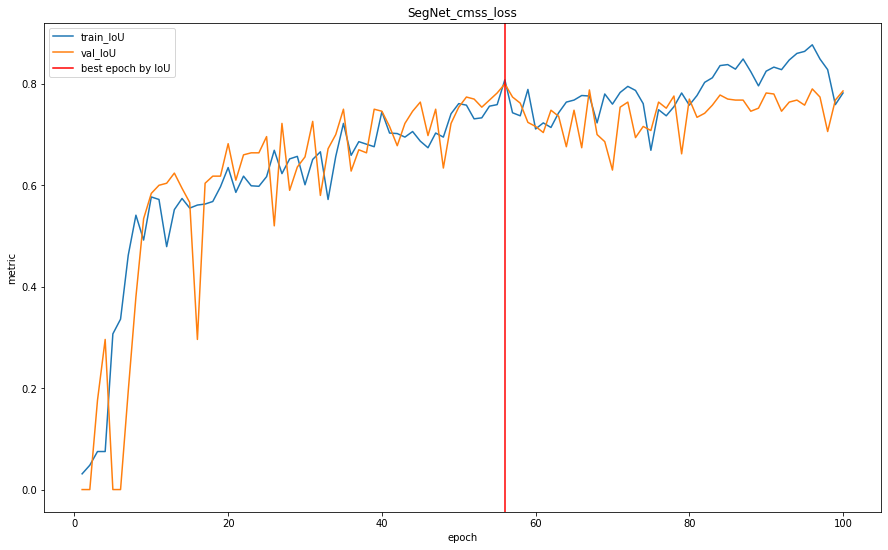

SegNet_cmss_loss: best IoU value 0.7999999523162842 on 56 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = SegNet().to(DEVICE)
model_name = "SegNet_cmss_loss"
criterion = CorrelationMaximizedStructuralSimilarityLoss(channels=1).to(DEVICE)
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4) 

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

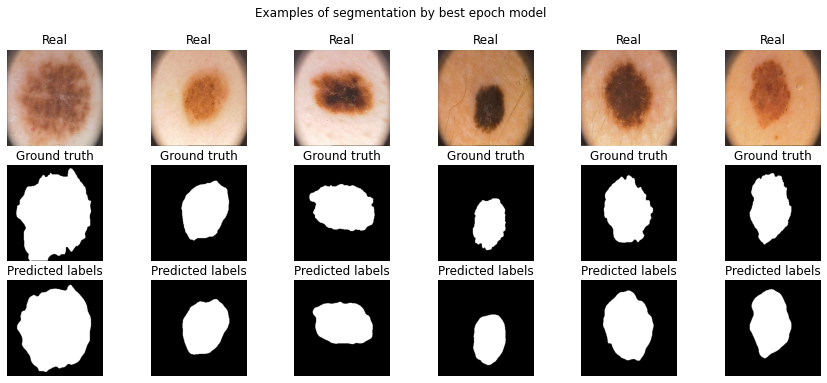

0.7999999523162842

In [ ]:
model_name = "SegNet_cmss_loss"
net = SegNet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("SegNet & cmss loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

-----------------------------------------------------------------------------------------

# U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Учитывая медицинское изображение, он выводит изображение в оттенках серого, представляющее вероятность того, что каждый пиксель является интересующей областью.

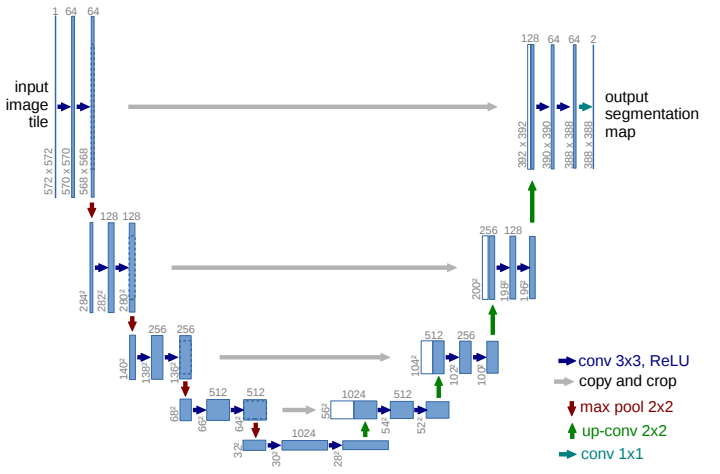

У нас в архитектуре все так же существует енкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются skip-conenctions. Элементы соединяющие части декодера и енкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

In [ ]:
from torchvision.transforms.functional import center_crop

class UNet(nn.Module):
    def __init__(self, padding=1):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2)  # as in the original paper
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )

        # decoder (upsampling)
        self.upsample0 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=3, padding=padding),
        )
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample1 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=padding),
        )
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=padding),
        )
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample3 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=padding),
        )
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        pooled = self.pool0(e0)
        e1 = self.enc_conv1(pooled)
        pooled = self.pool1(e1)
        e2 = self.enc_conv2(pooled)
        pooled = self.pool2(e2)
        e3 = self.enc_conv3(pooled)
        pooled = self.pool3(e3)

        # bottleneck
        b = self.bottleneck_conv(pooled)

        # decoder
        upsampled = self.upsample0(b)
        e3_cropped = center_crop(e3, upsampled.shape[-2:])
        concatenated = torch.cat((e3_cropped, upsampled), dim=1)
        d0 = self.dec_conv0(concatenated)
        upsampled = self.upsample1(d0)
        e2_cropped = center_crop(e2, upsampled.shape[-2:])
        concatenated = torch.cat((e2_cropped, upsampled), dim=1)
        d1 = self.dec_conv1(concatenated)
        upsampled = self.upsample2(d1)
        e1_cropped = center_crop(e1, upsampled.shape[-2:])
        concatenated = torch.cat((e1_cropped, upsampled), dim=1)
        d2 = self.dec_conv2(concatenated)
        upsampled = self.upsample3(d2)
        e0_cropped = center_crop(e0, upsampled.shape[-2:])
        concatenated = torch.cat((e0_cropped, upsampled), dim=1)
        d3 = self.dec_conv3(concatenated)  # no activation
        return d3

In [ ]:
from torchsummary import summary


model = UNet().to(DEVICE)
summary(model, (3, *IMG_SIZE));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

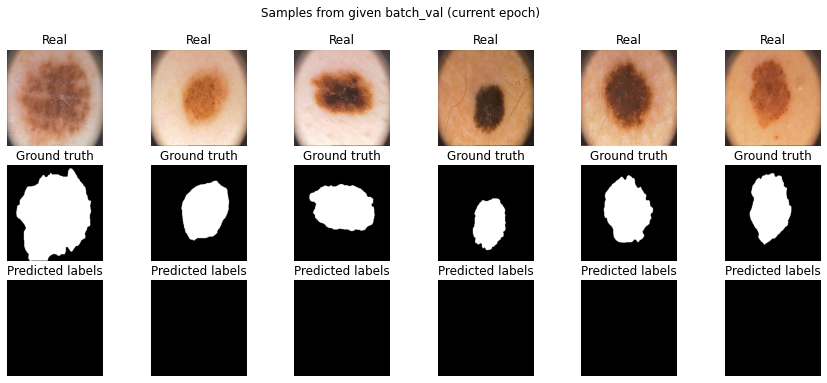

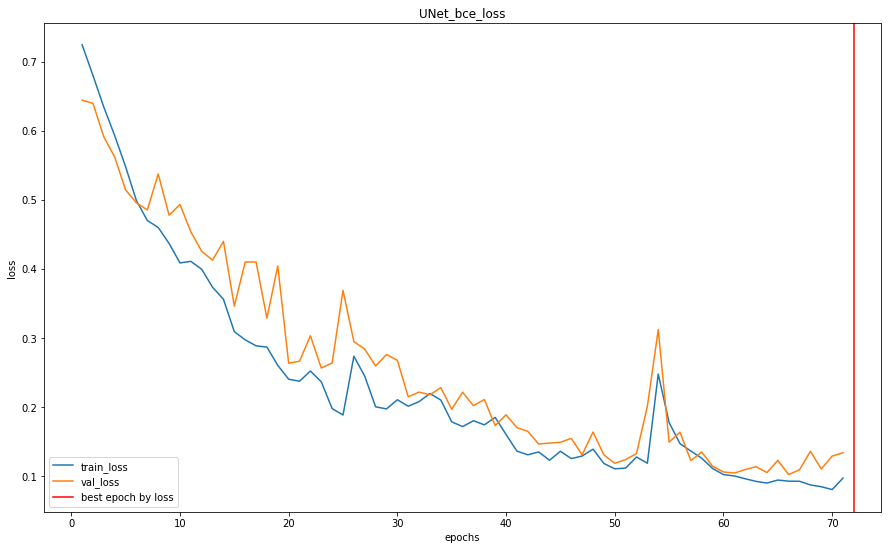

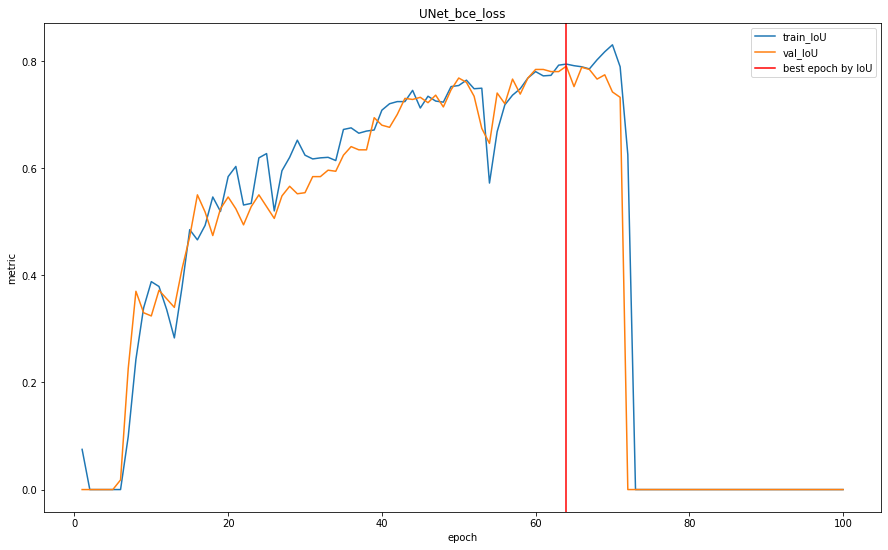

UNet_bce_loss: best IoU value 0.7899999618530273 on 64 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = UNet().to(DEVICE)
model_name = "UNet_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4) 

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

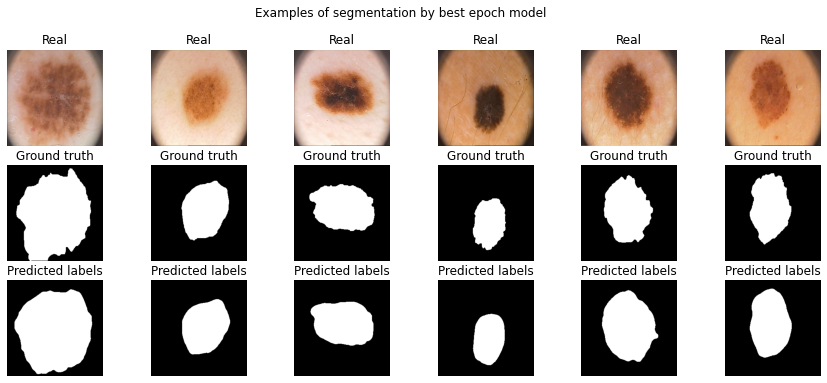

0.7899999618530273

In [ ]:
model_name = "UNet_bce_loss"
net = UNet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("UNet & bce loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


In [25]:
from torchvision.transforms.functional import center_crop

class UNet2(nn.Module):
    def __init__(self, padding=1):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool0 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=2, stride=2)
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool1 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=2, stride=2)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool2 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=2, stride=2)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )  
        self.pool3 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=2, stride=2)

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )

        # decoder (upsampling)
        self.upsample0 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=2, stride=2)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample1 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=2, stride=2)
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=2, stride=2)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True)
        )
        self.upsample3 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=2, stride=2)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=padding),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        pooled = self.pool0(e0)
        e1 = self.enc_conv1(pooled)
        pooled = self.pool1(e1)
        e2 = self.enc_conv2(pooled)
        pooled = self.pool2(e2)
        e3 = self.enc_conv3(pooled)
        pooled = self.pool3(e3)

        # bottleneck
        b = self.bottleneck_conv(pooled)

        # decoder
        upsampled = self.upsample0(b)
        e3_cropped = center_crop(e3, upsampled.shape[-2:])
        concatenated = torch.cat((e3_cropped, upsampled), dim=1)
        d0 = self.dec_conv0(concatenated)
        upsampled = self.upsample1(d0)
        e2_cropped = center_crop(e2, upsampled.shape[-2:])
        concatenated = torch.cat((e2_cropped, upsampled), dim=1)
        d1 = self.dec_conv1(concatenated)
        upsampled = self.upsample2(d1)
        e1_cropped = center_crop(e1, upsampled.shape[-2:])
        concatenated = torch.cat((e1_cropped, upsampled), dim=1)
        d2 = self.dec_conv2(concatenated)
        upsampled = self.upsample3(d2)
        e0_cropped = center_crop(e0, upsampled.shape[-2:])
        concatenated = torch.cat((e0_cropped, upsampled), dim=1)
        d3 = self.dec_conv3(concatenated)  # no activation
        return d3

In [26]:
from torchsummary import summary


model = UNet2().to(DEVICE)
summary(model, (3, *IMG_SIZE));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
            Conv2d-5         [-1, 64, 128, 128]          16,448
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
           Conv2d-10          [-1, 128, 64, 64]          65,664
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

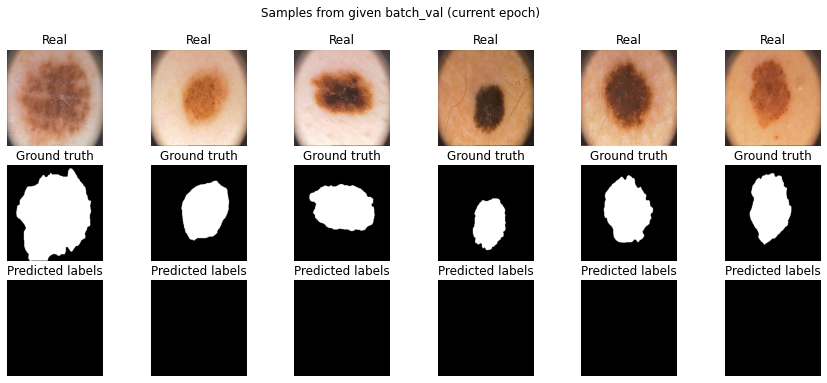

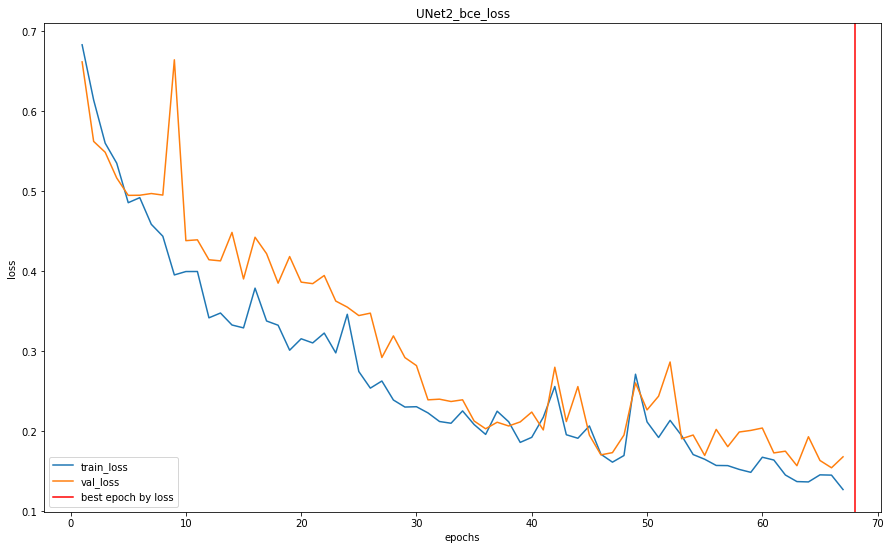

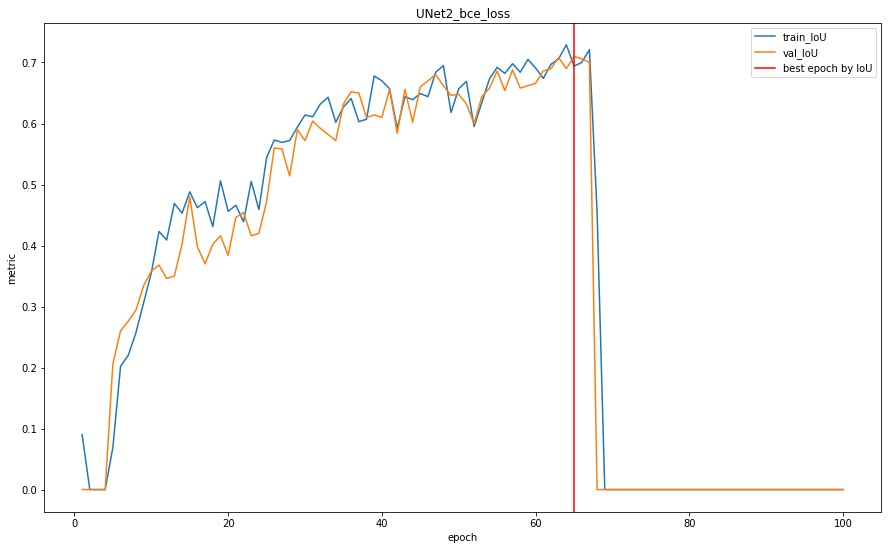

UNet2_bce_loss: best IoU value 0.7099999785423279 on 65 epoch.


In [ ]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = UNet2().to(DEVICE)
model_name = "UNet2_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4) 

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

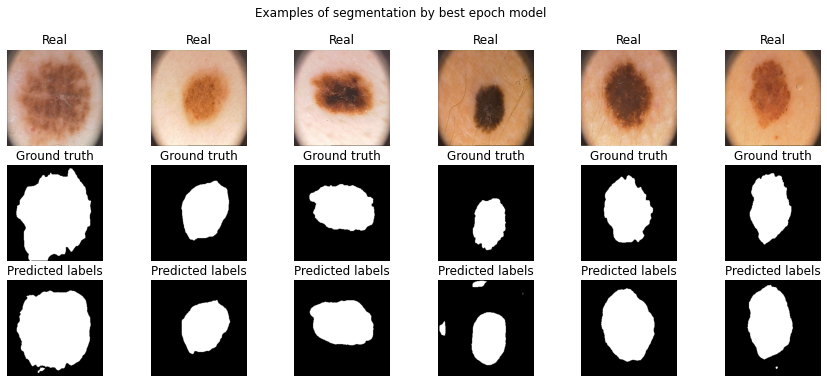

0.7099999785423279

In [ ]:
model_name = "UNet2_bce_loss"
net = UNet2().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("UNet2 & bce loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

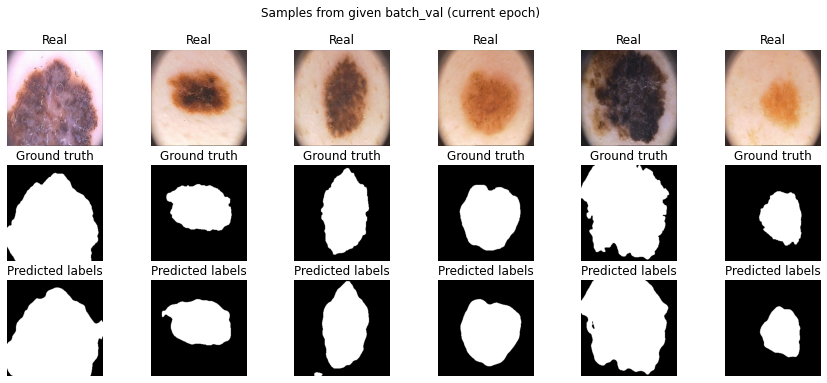

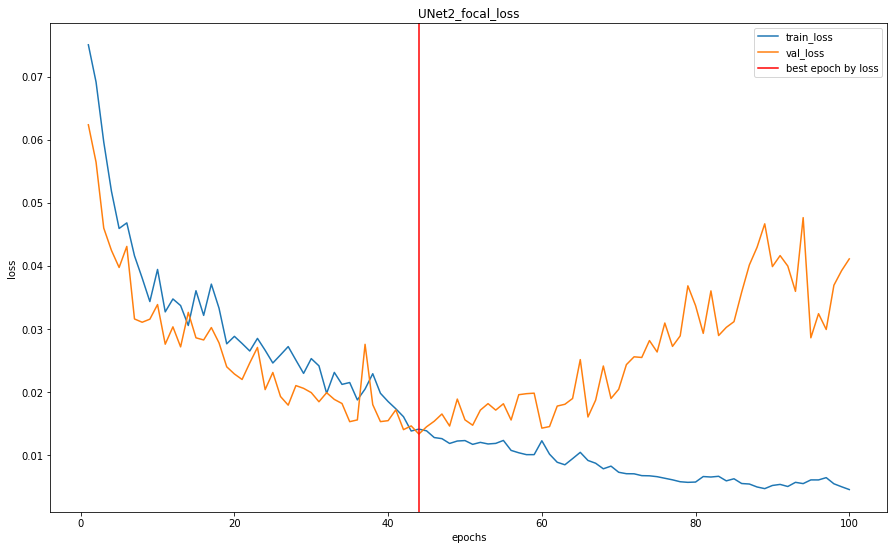

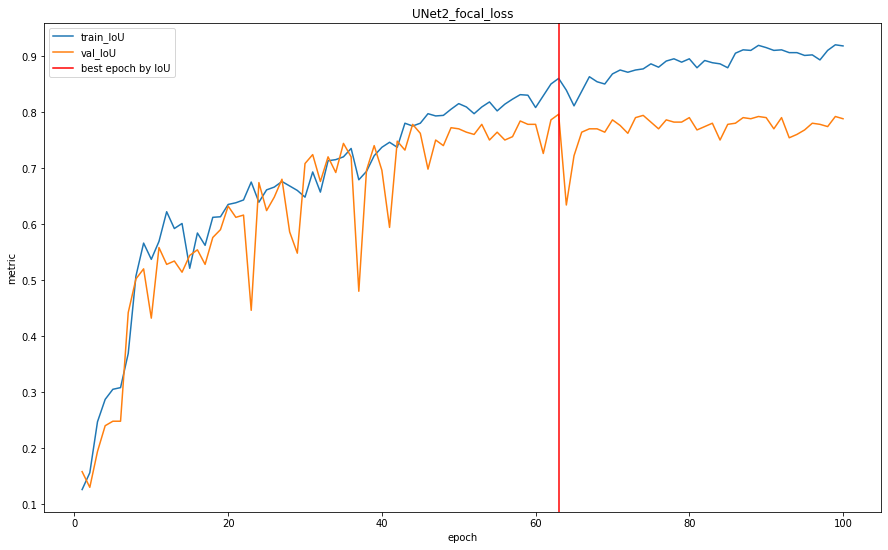

UNet2_focal_loss: best IoU value 0.796000063419342 on 63 epoch.


In [28]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = UNet2().to(DEVICE)
model_name = "UNet2_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4) 

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

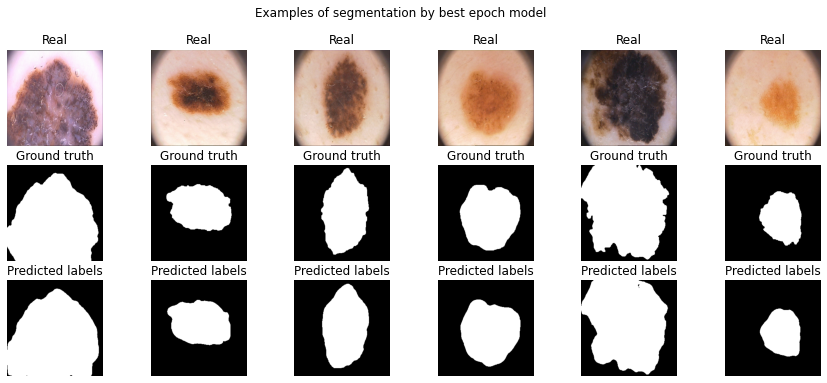

0.796000063419342

In [30]:
model_name = "UNet2_focal_loss"
net = UNet2().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("UNet2 & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

Сделайте вывод какая из моделей лучше

# Custom UNet

In [35]:
class MyUnet(nn.Module):
  def __init__(self):
    super().__init__()
    self.enc_conv0_0_0 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding=1)
    self.enc_conv0_1_0 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
    self.enc_conv0_1_1 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=5, padding=2)
    self.pool0 = nn.MaxPool2d(kernel_size=2)
    self.enc_conv1_0_0 = nn.Conv2d(in_channels=64, out_channels=96, kernel_size=3, padding=1)
    self.enc_conv1_1_0 = nn.Conv2d(in_channels=96, out_channels=128, kernel_size=3, padding=1)
    self.enc_conv1_1_1 = nn.Conv2d(in_channels=96, out_channels=128, kernel_size=5, padding=2)
    self.pool1 =  nn.MaxPool2d(kernel_size=2)
    self.enc_conv2_0_0 = nn.Conv2d(in_channels=256, out_channels=320, kernel_size=3, padding=1)
    self.enc_conv2_1_1 = nn.Conv2d(in_channels=320, out_channels=400, kernel_size=5, padding=2)
    self.enc_conv2_1_0 = nn.Conv2d(in_channels=320, out_channels=400, kernel_size=3, padding=1)
    self.pool2 =  nn.MaxPool2d(kernel_size=2)
    self.enc_conv3_0_0 = nn.Conv2d(in_channels=800, out_channels=1000, kernel_size=3, padding=1)
    self.enc_conv3_1_0 = nn.Conv2d(in_channels=1000, out_channels=1250, kernel_size=3, padding=1)
    self.enc_conv3_1_1 = nn.Conv2d(in_channels=1000, out_channels=1250, kernel_size=5, padding=2)
    self.pool3 =  nn.MaxPool2d(kernel_size=2)

    self.bottle = nn.Conv2d(in_channels=2500, out_channels=2500, kernel_size=1).to(DEVICE)
    
    self.upsample0 = nn.UpsamplingBilinear2d(size=(32, 32)).to(DEVICE)
    self.dec_conv0_0 = nn.Conv2d(in_channels=2500, out_channels=1250, kernel_size=3, padding=1)
    self.dec_conv0_1 = nn.Conv2d(in_channels=1250, out_channels=800, kernel_size=3, padding=1)
    self.upsample1 = nn.UpsamplingBilinear2d(size=(64, 64))
    self.dec_conv1_0 = nn.Conv2d(in_channels=1600, out_channels=800, kernel_size=3, padding=1)
    self.dec_conv1_1 = nn.Conv2d(in_channels=800, out_channels=400, kernel_size=3, padding=1)
    self.dec_conv1_2 = nn.Conv2d(in_channels=400, out_channels=256, kernel_size=3, padding=1)
    self.upsample2 = nn.UpsamplingBilinear2d(size=(128, 128))
    self.dec_conv2_0 = nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1)
    self.dec_conv2_1 = nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1)
    self.dec_conv2_2 = nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1)
    self.upsample3 = nn.UpsamplingBilinear2d(size=(256, 256))
    self.dec_conv3_0 = nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1)
    self.dec_conv3_1 = nn.Conv2d(in_channels=64, out_channels=16, kernel_size=3, padding=1)
    self.dec_conv3_2 = nn.Conv2d(in_channels=16, out_channels=1, kernel_size=3, padding=1)

  def forward(self, x):
    e0_0 = nn.Sequential(
        self.enc_conv0_0_0,
        nn.ReLU(),
        nn.BatchNorm2d(16)
    ).to(DEVICE)
    e0_1 = nn.Sequential(
        self.enc_conv0_1_0,
        nn.ReLU(),
        nn.BatchNorm2d(32)
    ).to(DEVICE)
    e0_2 = nn.Sequential(
        self.enc_conv0_1_1,
        nn.ReLU(),
        nn.BatchNorm2d(32)
    ).to(DEVICE)
    e0first = e0_0(x.to(DEVICE))
    e0r = F.relu(torch.cat([e0_1(e0first), e0_2(e0first)], dim=1))
    e1_0 = nn.Sequential(
        self.enc_conv1_0_0,
        nn.ReLU(),
        nn.BatchNorm2d(96)
    ).to(DEVICE)
    e1_1 = nn.Sequential(
        self.enc_conv1_1_0,
        nn.ReLU(),
        nn.BatchNorm2d(128)
    ).to(DEVICE)
    e1_2 = nn.Sequential(
        self.enc_conv1_1_1,
        nn.ReLU(),
        nn.BatchNorm2d(128)
    ).to(DEVICE)
    e1first = e1_0(self.pool0(e0r))
    e1r = F.relu(torch.cat([e1_1(e1first), e1_2(e1first)], dim=1))
    e2_0 = nn.Sequential(
        self.enc_conv2_0_0,
        nn.ReLU(),
        nn.BatchNorm2d(320)
    ).to(DEVICE)
    e2_1 = nn.Sequential(
        self.enc_conv2_1_0,
        nn.ReLU(),
        nn.BatchNorm2d(400)
    ).to(DEVICE)
    e2_2 = nn.Sequential(
        self.enc_conv2_1_1,
        nn.ReLU(),
        nn.BatchNorm2d(400)
    ).to(DEVICE)
    e2first = e2_0(self.pool1(e1r))
    e2r = F.relu(torch.cat([e2_1(e2first), e2_2(e2first)], dim=1))
    e3_0 = nn.Sequential(
        self.enc_conv3_0_0,
        nn.ReLU(),
        nn.BatchNorm2d(1000)
    ).to(DEVICE)
    e3_1 = nn.Sequential(
        self.enc_conv3_1_0,
        nn.ReLU(),
        nn.BatchNorm2d(1250)
    ).to(DEVICE)
    e3_2 = nn.Sequential(
        self.enc_conv3_1_1,
        nn.ReLU(),
        nn.BatchNorm2d(1250)
        ).to(DEVICE)
    e3first = e3_0(self.pool2(e2r))
    e3r = F.relu(torch.cat([e3_1(e3first), e3_2(e3first)], dim=1))

    b = self.upsample0(F.relu(self.bottle(self.pool3(e3r))))

    d0 = nn.Sequential(
        self.dec_conv0_0,
        nn.ReLU(),
        nn.BatchNorm2d(1250),
        self.dec_conv0_1,
        nn.ReLU(),
        nn.BatchNorm2d(800)
        ).to(DEVICE)
    d0r = self.upsample1(d0(b))
    d1 = nn.Sequential(
        self.dec_conv1_0,
        nn.ReLU(),
        nn.BatchNorm2d(800),
        self.dec_conv1_1,
        nn.ReLU(),
        nn.BatchNorm2d(400),
        self.dec_conv1_2,
        nn.ReLU(),
        nn.BatchNorm2d(256)
        ).to(DEVICE)
    d1r = self.upsample2(d1(torch.cat((d0r, e2r), dim=1)))
    d2 = nn.Sequential(
        self.dec_conv2_0,
        nn.ReLU(),
        nn.BatchNorm2d(256),
        self.dec_conv2_1,
        nn.ReLU(),
        nn.BatchNorm2d(128),
        self.dec_conv2_2,
        nn.ReLU(),
        nn.BatchNorm2d(64)
        ).to(DEVICE)
    d2r = self.upsample3(d2(torch.cat((d1r,e1r), dim=1)))
    d3 = nn.Sequential(
        self.dec_conv3_0,
        nn.ReLU(),
        nn.BatchNorm2d(64),
        self.dec_conv3_1,
        nn.ReLU(),
        nn.BatchNorm2d(16),
        self.dec_conv3_2,
        ).to(DEVICE)
    d3r = d3(torch.cat((d2r, e0r), dim=1))
    return d3r

In [37]:
from torchsummary import summary


model = MyUnet().to(DEVICE)
summary(model, (3, *IMG_SIZE));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 256, 256]             448
            Conv2d-2         [-1, 32, 256, 256]           4,640
            Conv2d-3         [-1, 32, 256, 256]          12,832
         MaxPool2d-4         [-1, 64, 128, 128]               0
            Conv2d-5         [-1, 96, 128, 128]          55,392
            Conv2d-6        [-1, 128, 128, 128]         110,720
            Conv2d-7        [-1, 128, 128, 128]         307,328
         MaxPool2d-8          [-1, 256, 64, 64]               0
            Conv2d-9          [-1, 320, 64, 64]         737,600
           Conv2d-10          [-1, 400, 64, 64]       1,152,400
           Conv2d-11          [-1, 400, 64, 64]       3,200,400
        MaxPool2d-12          [-1, 800, 32, 32]               0
           Conv2d-13         [-1, 1000, 32, 32]       7,201,000
           Conv2d-14         [-1, 1250,

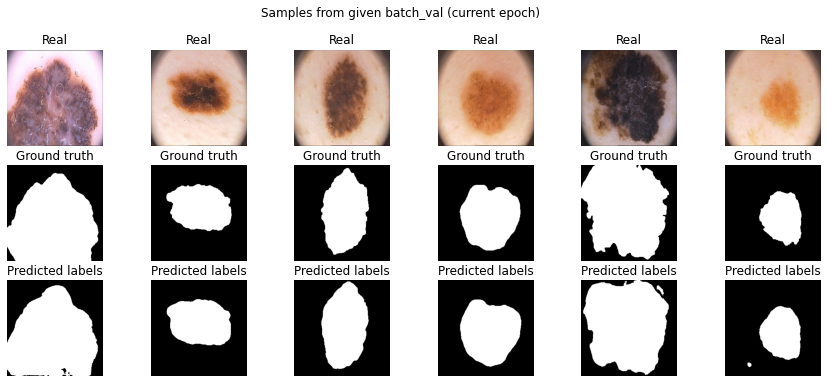

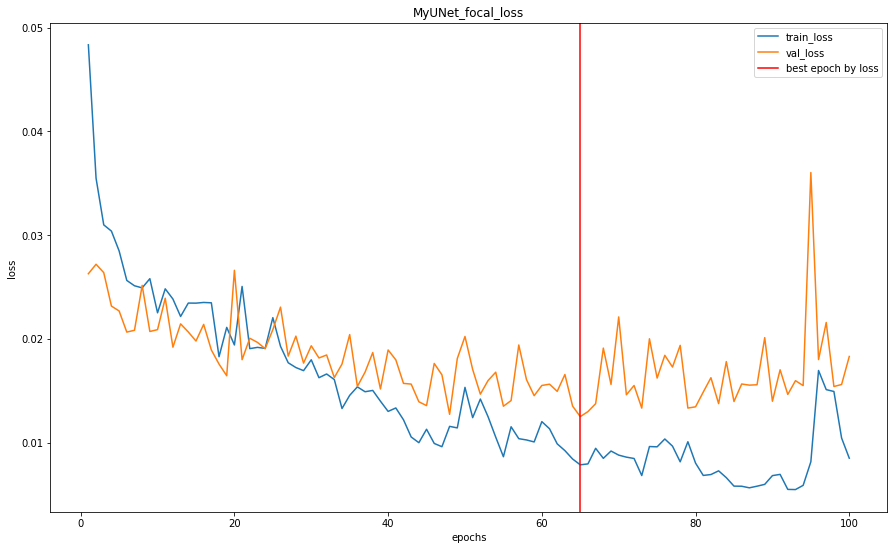

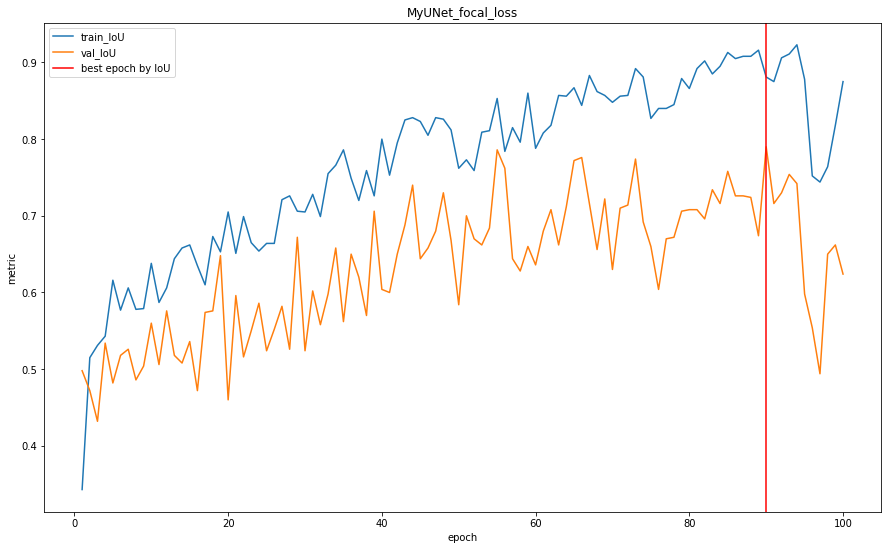

MyUNet_focal_loss: best IoU value 0.7899999618530273 on 90 epoch.


In [38]:
if 'net' in globals():
    del net
if 'optimizer' in globals():
    del optimizer
torch.cuda.empty_cache()

net = MyUnet().to(DEVICE)
model_name = "MyUNet_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(net.parameters(), lr=1e-4) 

train_loss, train_metrics, val_loss, val_metrics = train_model(
    net, data_tr, data_val, criterion, optimizer, epochs, DEVICE,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    train_loss, train_metrics, val_loss, val_metrics,
    model_name=model_name)
print_best_epoch(
    val_metrics[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

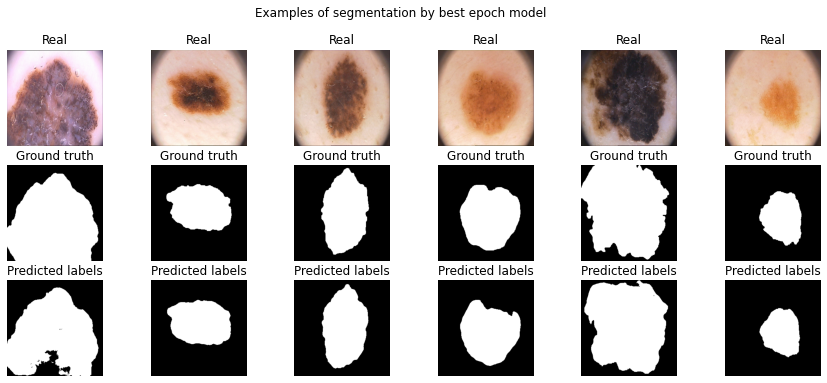

0.7899999618530273

In [39]:
model_name = "MyUNet_focal_loss"
net = MyUnet().to(DEVICE)
state = load_model_state_and_info(model_name, TrainType.TRAIN, DEVICE)

net.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(net, iou_pytorch, data_val)
test_score = score_model(net, iou_pytorch, data_ts)

update_models_data("MyUNet & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(net, title="Examples of segmentation by best epoch model")
val_score

# Отчет (6 баллов): 
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте. 
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии: 

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

In [40]:
import pandas as pd

In [ ]:
eval_summary = pd.DataFrame(models_data)
eval_summary.sort_values(by="test IoU", ascending=False, inplace=True)

В данной работе мы реализовали 2 нейросетевые архитектуры для решения задачи семантической сегментации:
-  SegNet;
-  U-Net.  

Так же мы мы провели сравнение данных архитектур использую различные функции потерь.
Для реализации SegNet было предложено использовать слой BottleNeck, но в результате тестирования модель без BottleNeck показала себя лучше и было решено оставить её. Ниже в таблице приведены метрики моделей:

In [58]:
eval_summary

,model & loss,best epoch,train loss,val IoU,test IoU
0,MyUNet & focal loss,90,0.013983,0.790,0.796
1,UNet2 & focal loss,63,0.018050,0.796,0.776
2,SegNet & focal loss,72,0.016136,0.818,0.744
3,SegNet & bce loss,76,0.138217,0.804,0.742
4,SegNet & cmss loss,56,0.239393,0.800,0.738
5,SegNet & dice loss,89,0.064666,0.808,0.736
6,UNet & bce loss,64,0.105034,0.790,0.706
7,UNet2 & bce loss,65,0.163597,0.710,0.672


Использованная нами метрика Intersection over Union (IoU), также известная как Jaccard index, — число от 0 до 1, показывающее, насколько у двух объектов (эталонного (ground true) и текущего) совпадает внутренний “объем”.  
У всех моделей присутствет небольшое переобучение на старших эпохах, но это не имеет критического влияния на результат валидации. На мой взгляд, для модели таких размеров датасет мал, что и вызывает переобучение.

Из функций потерь *Focal Loss* на нашем датасете показал себя лучше остальных.  
Поскольку данные несбалансированны, а функция *Focal Loss* устраняет дисбаланс классов во время обучения таким задачам, как обнаружение объектов. Фокусная потеря применяет модуляцию к потере перекрестной энтропии, чтобы сосредоточить обучение на сложных неправильно классифицированных примерах. Это динамически масштабируемая потеря перекрестной энтропии, при которой коэффициент масштабирования уменьшается до нуля по мере увеличения уверенности в правильности класса. Интуитивно понятно, что этот коэффициент масштабирования может автоматически уменьшить вклад простых примеров во время обучения и быстро сфокусировать модель на сложных примерах.

При имплементации потери Структурной Схожести, мы использовали Гауссово размытие, что скорее всего не совсем подходит для наших данных, результат виден на графиках модели, да и качесто хуже предшественников.

UNet с измененным пулингом и *Focal Loss* в качестве функции потерь показал наилучший результат.

Далее мы решили отступить от задания и добавить для сравнения свою версию модели с UNet архитектурой.  
Было решено отказаться от *transposed-conv*, так как такие свертки показывают себя стабильно хуже билинейного апсемплинга. Идея состояла в создание архитектуры, в которой переходы между разными слоями свёрток будут менее резкими по сокращению кол-ва фильтров, чтобы обобщающая сила сети была больше.  
Также использовались свертки разных размеров для того, чтобы можно было улавливать более тонкие детали. 

Наша модель имеет намного большую сложность (примерно в 100 раз больше параметров), соответственно для ее обучения потребуется больше времени и ресурсов. Для чистоты эксперимента было решено оставить 100 эпох, как и в предыдущих моделях.

Как видно из итоговой таблицы обопщающая мощность нашей модели даже на 100 эпохах превзошла **SegNet** и даже побила **UNet** первых имплементаций.

Из проделанной работы можно сделать вывод, что решая задачи *CV* и *ML*, стоит экспериментировать как с гиперпараметрами модели, так и с фунцией потерь. Нет какой-то лучшей функции и стоит исходить из специфики поставленной задачи и имеющихся данных.  
В нашем случае в сравнении двух архитектур победил **UNet**.